In [121]:
import pandas as pd
import numpy as np
from sklearn.neighbors import NearestNeighbors
import time
import sys
import matplotlib.pyplot as plt
from sklearn.cluster import MiniBatchKMeans
import seaborn as sns



def get_windows(job,n_neighbors):
    '''
    For each region and each individual cell in dataset, return the indices of the nearest neighbors.
    
    'job:  meta data containing the start time,index of region, region name, indices of region in original dataframe
    n_neighbors:  the number of neighbors to find for each cell
    '''
    start_time,idx,tissue_name,indices = job
    job_start = time.time()
    
    print ("Starting:", str(idx+1)+'/'+str(len(exps)),': ' + exps[idx])

    tissue = tissue_group.get_group(tissue_name)
    to_fit = tissue.loc[indices][[X,Y]].values

#     fit = NearestNeighbors(n_neighbors=n_neighbors+1).fit(tissue[[X,Y]].values)
    fit = NearestNeighbors(n_neighbors=n_neighbors).fit(tissue[[X,Y]].values)
    m = fit.kneighbors(to_fit)
#     m = m[0][:,1:], m[1][:,1:]
    m = m[0], m[1]
    

    #sort_neighbors
    args = m[0].argsort(axis = 1)
    add = np.arange(m[1].shape[0])*m[1].shape[1]
    sorted_indices = m[1].flatten()[args+add[:,None]]

    neighbors = tissue.index.values[sorted_indices]
   
    end_time = time.time()
   
    print ("Finishing:", str(idx+1)+"/"+str(len(exps)),": "+ exps[idx],end_time-job_start,end_time-start_time)
    return neighbors.astype(np.int32)


### ------------------------

### Fill In:
    -ks = individual window sizes to collect.  
        -This accelerates the process of trying different window sizes by collecting them all in one step.
    -path_to_data:  file path for csv file with x,y cluster information
    -X:  column to use for X location
    -Y:  column to use for Y location
    -reg:  column to use for region (should be different for every tissue)
    -file_type('csv','pickle'):  file type
    -cluster_col : column name of cell type cluster to be used for neighborhoods
    -cellhierpath:  path to cellhier libary (should only have to set once per computer
    -keep_cols:  columns to transfer from original dataframe to dataframe with windows and neighborhoods

In [122]:
ks = [5,10,20] # k=5 means it collects 5 nearest neighbors for each center cell
path_to_data = 'main_fcs_csv.csv'
X = 'X:X'
Y = 'Y:Y'
reg = 'File Name'
file_type = 'csv'

cluster_col = 'ClusterName'
keep_cols = [X,Y,reg,cluster_col]
save_path = ''


### ------------------------

In [123]:
#read in data and do some quick data rearrangement
n_neighbors = max(ks)
assert (file_type=='csv' or file_type =='pickle') #


if file_type == 'pickle':
    cells = pd.read_pickle(path_to_data)
if file_type == 'csv':
    cells = pd.read_csv(path_to_data)

# Create one-hot encoded columns
dummy_cols = pd.get_dummies(cells[cluster_col])
cells = pd.concat([cells, dummy_cols], axis=1)

#cells = cells.reset_index() #Uncomment this line if you do any subsetting of dataframe such as removing dirt etc or will throw error at end of next next code block (cell 6)

# Get the column names from the one-hot encoded columns (not from unique values)
# This ensures we're using the exact column names created by get_dummies
sum_cols = dummy_cols.columns.tolist()
values = cells[sum_cols].values

In [124]:
#find windows for each cell in each tissue region
tissue_group = cells[[X,Y,reg]].groupby(reg)
exps = list(cells[reg].unique())
tissue_chunks = [(time.time(),exps.index(t),t,a) for t,indices in tissue_group.groups.items() for a in np.array_split(indices,1)] 
tissues = [get_windows(job,n_neighbors) for job in tissue_chunks]


Starting: 1/17 : tile_15077_29493
Finishing: 1/17 : tile_15077_29493 0.0833730697631836 0.08452129364013672
Starting: 2/17 : tile_18411_11726
Finishing: 2/17 : tile_18411_11726 0.07264184951782227 0.15787315368652344
Starting: 3/17 : tile_26582_61782
Finishing: 3/17 : tile_26582_61782 0.020348548889160156 0.1797189712524414
Starting: 4/17 : tile_28352_36003
Finishing: 4/17 : tile_28352_36003 0.04866218566894531 0.22860264778137207
Starting: 5/17 : tile_35394_49679
Finishing: 5/17 : tile_35394_49679 0.04512667655944824 0.2746241092681885
Starting: 6/17 : tile_42392_16289
Finishing: 6/17 : tile_42392_16289 0.051369667053222656 0.32717323303222656
Starting: 7/17 : tile_42491_40304
Finishing: 7/17 : tile_42491_40304 0.050871849060058594 0.3787503242492676
Starting: 8/17 : tile_43524_27841
Finishing: 8/17 : tile_43524_27841 0.04883074760437012 0.428027868270874
Starting: 9/17 : tile_43924_60693
Finishing: 9/17 : tile_43924_60693 0.09173917770385742 0.5199184417724609
Starting: 10/17 : tile_

In [125]:
#for each cell and its nearest neighbors, reshape and count the number of each cell type in those neighbors.
out_dict = {}
for k in ks:
    for neighbors,job in zip(tissues,tissue_chunks):

        chunk = np.arange(len(neighbors))#indices
        tissue_name = job[2]
        indices = job[3]
        window = values[neighbors[chunk,:k].flatten()].reshape(len(chunk),k,len(sum_cols)).sum(axis = 1)
        out_dict[(tissue_name,k)] = (window.astype(np.float16),indices)

#concatenate the summed windows and combine into one dataframe for each window size tested.
windows = {}
for k in ks:
   
    window = pd.concat([pd.DataFrame(out_dict[(exp,k)][0],index = out_dict[(exp,k)][1].astype(int),columns = sum_cols) for exp in exps], axis=0)
    window = window.loc[cells.index.values]
    window = pd.concat([cells[keep_cols],window], axis=1)
    windows[k] = window


### ------------------------

### Fill In:
    -k:  window_size (needs to be in ks (saved above))
    -n_neighborhoods:  number of neighborhoods to find

In [126]:
# 1 Follicular (Crohn's Like)
# 2 Diffuse

In [127]:
k = 20
n_neighborhoods = 8
neighborhood_name = "neighborhood"+str(k)
k_centroids = {}

In [128]:
windows2 = windows[10]
# windows2[cluster_col] = cells[cluster_col]

km = MiniBatchKMeans(n_clusters = n_neighborhoods,random_state=0)

labelskm = km.fit_predict(windows2[sum_cols].values)
k_centroids[k] = km.cluster_centers_
# Add 1 to labels to make neighborhoods 1-indexed (1-7 instead of 0-6)
cells[neighborhood_name] = labelskm + 1
cells[neighborhood_name] = cells[neighborhood_name].astype('category')
#['reg064_A','reg066_A','reg018_B','reg023_A']


In [129]:
# Save cells dataframe with neighborhoods for use in other notebooks (e.g., cca_cleaned_up.ipynb)
# This saves the dataframe with all the neighborhood assignments and one-hot encoded cell types
save_path_csv = 'cells_with_neighborhoods.csv'
save_path_pkl = 'cells_with_neighborhoods.pkl'

# Save as CSV (human-readable, but slower to load)
cells.to_csv(save_path_csv, index=False)
print(f"Saved cells dataframe with neighborhoods to: {save_path_csv}")

# Also save as pickle (faster to load, preserves data types better)
cells.to_pickle(save_path_pkl)
print(f"Saved cells dataframe with neighborhoods to: {save_path_pkl}")

print(f"\nNeighborhood column '{neighborhood_name}' has been saved.")
# Convert to numeric to get min/max (categorical columns need to be ordered for min/max)
neighborhood_values = pd.to_numeric(cells[neighborhood_name], errors='coerce')
print(f"Neighborhood values range: {neighborhood_values.min():.0f} to {neighborhood_values.max():.0f}")
print(f"Total cells: {len(cells)}")


Saved cells dataframe with neighborhoods to: cells_with_neighborhoods.csv
Saved cells dataframe with neighborhoods to: cells_with_neighborhoods.pkl

Neighborhood column 'neighborhood20' has been saved.
Neighborhood values range: 1 to 8
Total cells: 341888


In [130]:
cell_order = ['tumor cells', 'CD11c+ DCs', 'tumor cells / immune cells',
       'smooth muscle', 'lymphatics', 'adipocytes', 'undefined',
       'CD4+ T cells CD45RO+', 'CD8+ T cells', 'CD68+CD163+ macrophages',
       'plasma cells', 'Tregs', 'immune cells / vasculature', 'stroma',
       'CD68+ macrophages GzmB+', 'vasculature', 'nerves',
       'CD11b+CD68+ macrophages', 'granulocytes', 'CD68+ macrophages',
       'NK cells', 'CD11b+ monocytes', 'immune cells',
       'CD4+ T cells GATA3+', 'CD163+ macrophages', 'CD3+ T cells',
       'CD4+ T cells', 'B cells']

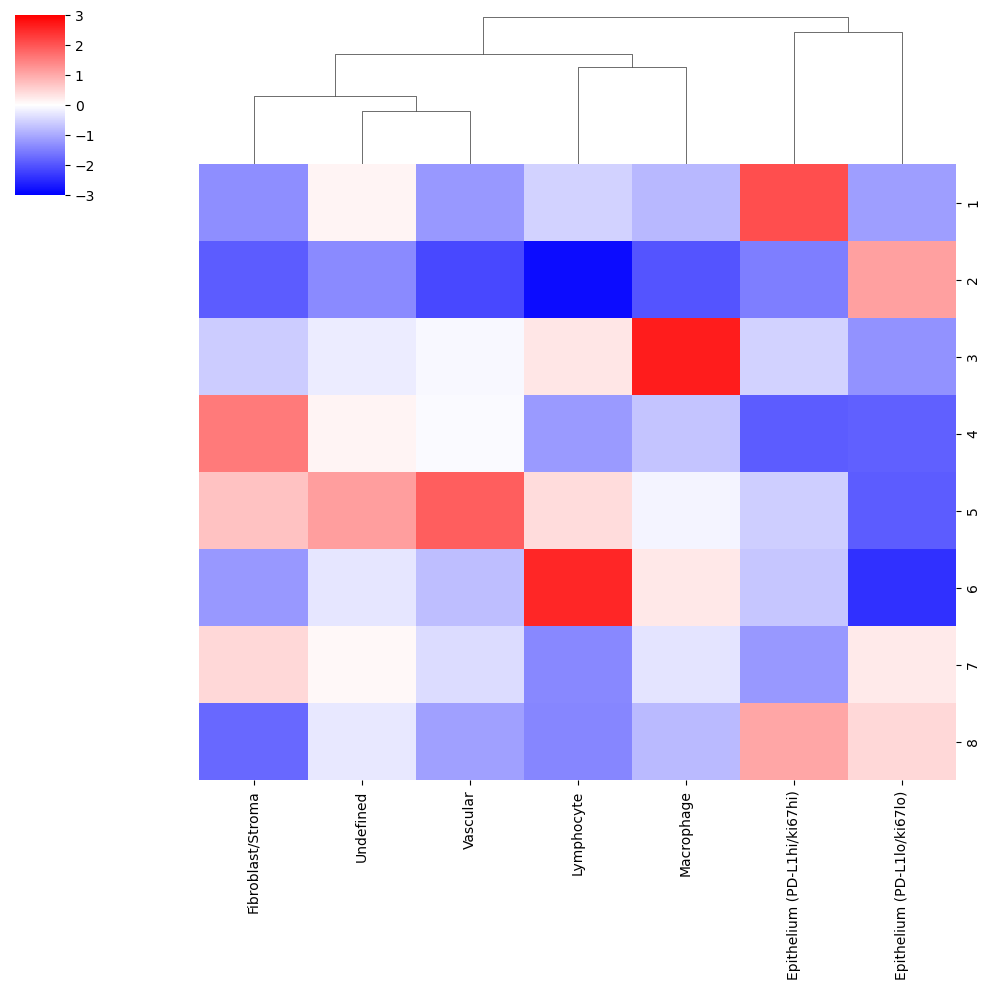

In [131]:
# this plot shows the types of cells (ClusterIDs) in the different niches (1-7)
# Use the same k value that was used for clustering
# Check what keys are available in k_centroids
if 'k' in locals() or 'k' in globals():
    k_to_plot = k  # Use the k value from clustering
else:
    # If k is not available, use the first available key in k_centroids
    k_to_plot = list(k_centroids.keys())[0] if k_centroids else 20
    print(f"Using k_to_plot = {k_to_plot} (available keys: {list(k_centroids.keys())})")

niche_clusters = (k_centroids[k_to_plot])
tissue_avgs = values.mean(axis = 0)
fc = np.log2(((niche_clusters+tissue_avgs)/(niche_clusters+tissue_avgs).sum(axis = 1, keepdims = True))/tissue_avgs)
fc = pd.DataFrame(fc,columns = sum_cols)
# Rename index to 1-indexed neighborhoods (1-7) instead of 0-indexed (0-6)
fc.index = range(1, len(fc) + 1)

# Filter cell_order to only include columns that actually exist in fc
# If cell_order is not defined or doesn't match, use all available columns
if 'cell_order' in locals() or 'cell_order' in globals():
    # Only use cell types that exist in the dataframe
    available_cell_order = [col for col in cell_order if col in fc.columns]
    if not available_cell_order:
        # If none match, use all columns
        available_cell_order = sum_cols
        print(f"Warning: cell_order doesn't match columns. Using all available cell types: {available_cell_order}")
    else:
        print(f"Using {len(available_cell_order)} cell types from cell_order")
else:
    # If cell_order is not defined, use all columns
    available_cell_order = sum_cols
    print(f"cell_order not defined. Using all available cell types: {available_cell_order}")

# Select rows (neighborhoods) - include all neighborhoods (now indexed 1-7)
neighborhoods_to_plot = list(range(1, len(fc) + 1))  # Include all neighborhoods 1-7

s=sns.clustermap(fc.loc[neighborhoods_to_plot, available_cell_order], vmin =-3,vmax = 3,cmap = 'bwr',row_cluster = False)
# s.savefig("raw_figs/celltypes_perniche_10.pdf")


'groups' column not found. Plotting all data.


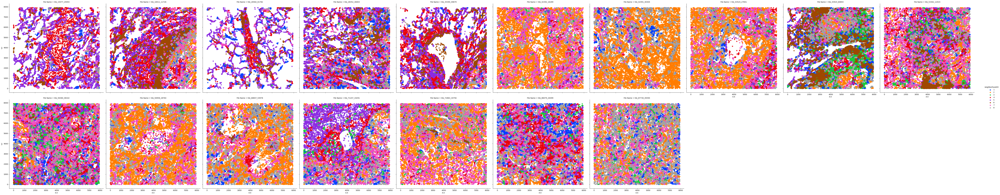

In [132]:
# Find the neighborhood column name (should be 'neighborhood20' if k=20 was used)
neighborhood_col = None
if 'neighborhood_name' in locals() or 'neighborhood_name' in globals():
    neighborhood_col = neighborhood_name
else:
    # Find the neighborhood column dynamically
    neighborhood_cols = [col for col in cells.columns if col.startswith('neighborhood') and col[10:].isdigit()]
    if neighborhood_cols:
        neighborhood_col = neighborhood_cols[0]
        print(f"Using neighborhood column: {neighborhood_col}")
    else:
        raise KeyError("No neighborhood column found. Make sure clustering has been run.")

cells[neighborhood_col] = cells[neighborhood_col].astype('category')

# Check if 'groups' column exists, if not plot all data
if 'groups' in cells.columns:
    plot_data = cells[cells['groups']==1]
    print("Plotting data for group 1")
else:
    plot_data = cells
    print("'groups' column not found. Plotting all data.")

sns.lmplot(data = plot_data, x = 'X:X', y='Y:Y', hue = neighborhood_col, palette = 'bright', height = 8, col = reg, col_wrap = 10, fit_reg = False)



'groups' column not found. Plotting all data.


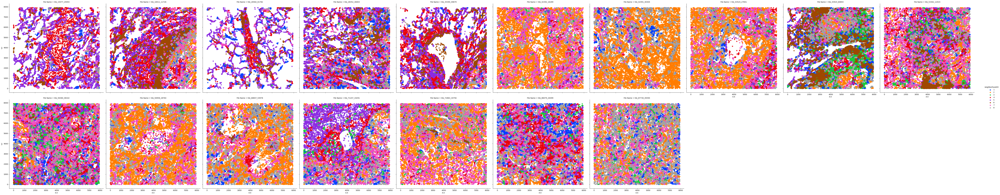

In [133]:
# Use the same neighborhood column as defined above
if 'neighborhood_col' not in locals() and 'neighborhood_col' not in globals():
    # Find the neighborhood column dynamically
    neighborhood_cols = [col for col in cells.columns if col.startswith('neighborhood') and col[10:].isdigit()]
    if neighborhood_cols:
        neighborhood_col = neighborhood_cols[0]
    else:
        raise KeyError("No neighborhood column found. Make sure clustering has been run.")

cells[neighborhood_col] = cells[neighborhood_col].astype('category')

# Check if 'groups' column exists, if not plot all data
if 'groups' in cells.columns:
    plot_data = cells[cells['groups']==2]
    print("Plotting data for group 2")
else:
    plot_data = cells
    print("'groups' column not found. Plotting all data.")

sns.lmplot(data = plot_data, x = 'X:X', y='Y:Y', hue = neighborhood_col, palette = 'bright', height = 8, col = reg, col_wrap = 10, fit_reg = False)


###### -------------------------------

'groups' and 'patients' columns not found. Showing overall neighborhood frequencies.


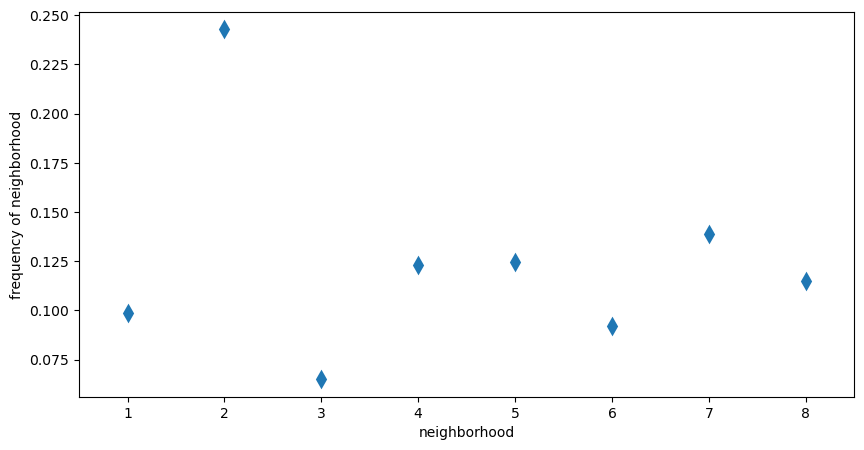

In [134]:
#plot for each group and each patient the percent of total cells allocated to each neighborhood
# Use the neighborhood column (should be 'neighborhood20' if k=20 was used)
if 'neighborhood_col' not in locals() and 'neighborhood_col' not in globals():
    neighborhood_cols = [col for col in cells.columns if col.startswith('neighborhood') and col[10:].isdigit()]
    neighborhood_col = neighborhood_cols[0] if neighborhood_cols else 'neighborhood10'

# Check if 'groups' and 'patients' columns exist
if 'groups' in cells.columns and 'patients' in cells.columns:
    fc = cells.groupby(('patients','groups')).apply(lambda x: x[neighborhood_col].value_counts(sort = False,normalize = True))
elif 'patients' in cells.columns:
    # If only 'patients' exists, group by patients only
    fc = cells.groupby('patients').apply(lambda x: x[neighborhood_col].value_counts(sort = False,normalize = True))
    print("'groups' column not found. Grouping by patients only.")
else:
    # If neither exists, just get value counts
    fc = pd.DataFrame(cells[neighborhood_col].value_counts(sort = False,normalize = True)).T
    print("'groups' and 'patients' columns not found. Showing overall neighborhood frequencies.")

# Keep natural neighborhood labels (1-7) instead of forcing range(10)
# fc.columns = range(10)  # Removed - let columns be natural neighborhood labels
fc_reset = fc.reset_index()

# Determine which id_vars to use based on what columns exist
id_vars = []
if 'patients' in fc_reset.columns:
    id_vars.append('patients')
if 'groups' in fc_reset.columns:
    id_vars.append('groups')

if len(id_vars) == 0:
    # If no grouping columns, create a dummy one for plotting
    fc_reset['all_data'] = 'all'
    id_vars = ['all_data']

# Get the value columns (neighborhood columns) - exclude id_vars and 'index' if it exists
value_cols = [col for col in fc_reset.columns if col not in id_vars and col != 'index']
melt = pd.melt(fc_reset, id_vars=id_vars, value_vars=value_cols, value_name='frequency of neighborhood', var_name='neighborhood')

# Clean the data: remove NaN values and ensure correct data types
# Convert neighborhood to string for categorical plotting (handle any numeric values)
# First try to convert to numeric, then to string
try:
    melt['neighborhood'] = pd.to_numeric(melt['neighborhood'], errors='coerce')
    melt = melt.dropna(subset=['neighborhood'])  # Remove rows where neighborhood couldn't be converted
    melt['neighborhood'] = melt['neighborhood'].astype(int).astype(str)
except:
    # If conversion fails, just convert to string directly
    melt['neighborhood'] = melt['neighborhood'].astype(str)
# Ensure frequency is numeric and remove any NaN values
melt['frequency of neighborhood'] = pd.to_numeric(melt['frequency of neighborhood'], errors='coerce')
melt = melt.dropna(subset=['frequency of neighborhood'])

# Ensure all id_vars columns are properly formatted (convert any float columns to appropriate types)
for col in id_vars:
    if col in melt.columns:
        # Convert to string if it's not already categorical
        if melt[col].dtype == 'float64':
            melt[col] = melt[col].fillna('').astype(str)
        elif pd.api.types.is_numeric_dtype(melt[col]):
            melt[col] = melt[col].astype(str)

f,ax = plt.subplots(figsize = (10,5))

# Only use hue='groups' if groups column exists
hue_col = 'groups' if 'groups' in melt.columns else None
if hue_col:
    sns.stripplot(data = melt, hue = hue_col, dodge = True, alpha = .2, x ='neighborhood', y ='frequency of neighborhood')
    sns.pointplot(data = melt, markers = 'd', hue = hue_col, dodge = .5, linestyle = 'none', x ='neighborhood', y ='frequency of neighborhood')
else:
    sns.stripplot(data = melt, alpha = .2, x ='neighborhood', y ='frequency of neighborhood')
    sns.pointplot(data = melt, markers = 'd', linestyle = 'none', x ='neighborhood', y ='frequency of neighborhood')

# Only create legend if groups exist
if hue_col and 'groups' in melt.columns:
    handles, labels = ax.get_legend_handles_labels()
    if len(handles) >= 2:
        ax.legend(handles[:2], labels[:2], title="Groups",
                  handletextpad=0, columnspacing=1,
                  loc="upper left", ncol=3, frameon=True)
    else:
        ax.legend(handles, labels, title="Groups",
                  handletextpad=0, columnspacing=1,
                  loc="upper left", ncol=3, frameon=True)

In [135]:
#t-test to evaluate if any neighborhood is enriched in one group
from scipy.stats import ttest_ind

# Check if 'groups' column exists in melt
if 'groups' in melt.columns:
    # Get actual neighborhoods present in the data (should be 1-7)
    neighborhoods_to_check = sorted([int(x) for x in melt['neighborhood'].unique() if str(x).isdigit()])
    if not neighborhoods_to_check:
        neighborhoods_to_check = list(range(1, 8))  # Default to 1-7 if none found
    for i in neighborhoods_to_check:
        n2 = melt[melt['neighborhood']==str(i)]
        if len(n2[n2['groups']==1]) > 0 and len(n2[n2['groups']==2]) > 0:
            print(i, '    ', ttest_ind(n2[n2['groups']==1]['frequency of neighborhood'], n2[n2['groups']==2]['frequency of neighborhood']))
        else:
            print(i, '    ', 'Insufficient data for t-test')
else:
    print("'groups' column not found. Cannot perform group comparisons.")
    print("Showing neighborhood frequencies:")
    print(melt.groupby('neighborhood')['frequency of neighborhood'].describe())

'groups' column not found. Cannot perform group comparisons.
Showing neighborhood frequencies:
              count      mean  std       min       25%       50%       75%  \
neighborhood                                                                 
1               1.0  0.098763  NaN  0.098763  0.098763  0.098763  0.098763   
2               1.0  0.242889  NaN  0.242889  0.242889  0.242889  0.242889   
3               1.0  0.065004  NaN  0.065004  0.065004  0.065004  0.065004   
4               1.0  0.123201  NaN  0.123201  0.123201  0.123201  0.123201   
5               1.0  0.124719  NaN  0.124719  0.124719  0.124719  0.124719   
6               1.0  0.092080  NaN  0.092080  0.092080  0.092080  0.092080   
7               1.0  0.138633  NaN  0.138633  0.138633  0.138633  0.138633   
8               1.0  0.114710  NaN  0.114710  0.114710  0.114710  0.114710   

                   max  
neighborhood            
1             0.098763  
2             0.242889  
3             0.065004  

'groups' and 'patients' columns not found. Showing overall neighborhood frequencies.


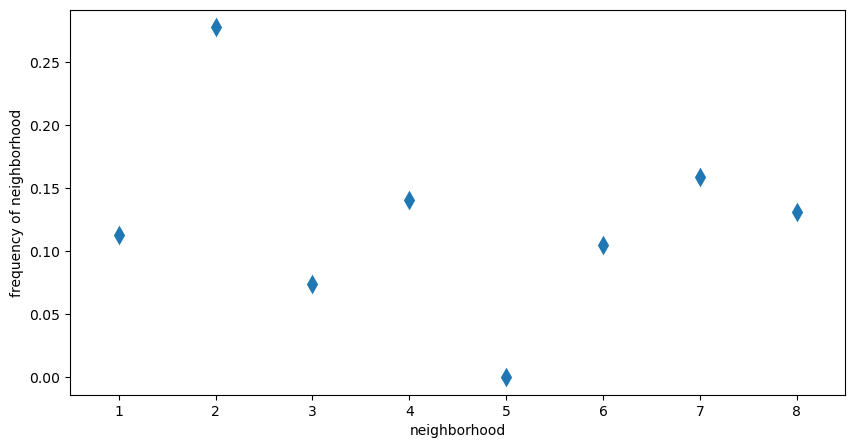

In [136]:
#same as above except neighborhood 5 is removed from analysis.
# Use the neighborhood column (should be 'neighborhood20' if k=20 was used)
if 'neighborhood_col' not in locals() and 'neighborhood_col' not in globals():
    neighborhood_cols = [col for col in cells.columns if col.startswith('neighborhood') and col[10:].isdigit()]
    neighborhood_col = neighborhood_cols[0] if neighborhood_cols else 'neighborhood10'

# Check if 'groups' and 'patients' columns exist
filtered_cells = cells[cells[neighborhood_col]!=5]
if 'groups' in filtered_cells.columns and 'patients' in filtered_cells.columns:
    fc = filtered_cells.groupby(('patients','groups')).apply(lambda x: x[neighborhood_col].value_counts(sort = False,normalize = True))
elif 'patients' in filtered_cells.columns:
    # If only 'patients' exists, group by patients only
    fc = filtered_cells.groupby('patients').apply(lambda x: x[neighborhood_col].value_counts(sort = False,normalize = True))
    print("'groups' column not found. Grouping by patients only.")
else:
    # If neither exists, just get value counts
    fc = pd.DataFrame(filtered_cells[neighborhood_col].value_counts(sort = False,normalize = True)).T
    print("'groups' and 'patients' columns not found. Showing overall neighborhood frequencies.")

# Keep natural neighborhood labels (1-7) instead of forcing range(10)
# fc.columns = range(10)  # Removed - let columns be natural neighborhood labels
fc_reset = fc.reset_index()

# Determine which id_vars to use based on what columns exist
id_vars = []
if 'patients' in fc_reset.columns:
    id_vars.append('patients')
if 'groups' in fc_reset.columns:
    id_vars.append('groups')

if len(id_vars) == 0:
    # If no grouping columns, create a dummy one for plotting
    fc_reset['all_data'] = 'all'
    id_vars = ['all_data']

# Get the value columns (neighborhood columns) - exclude id_vars and 'index' if it exists
value_cols = [col for col in fc_reset.columns if col not in id_vars and col != 'index']
melt = pd.melt(fc_reset, id_vars=id_vars, value_vars=value_cols, value_name='frequency of neighborhood', var_name='neighborhood')

# Clean the data: remove NaN values and ensure correct data types
# Convert neighborhood to string for categorical plotting (handle any numeric values)
# First try to convert to numeric, then to string
try:
    melt['neighborhood'] = pd.to_numeric(melt['neighborhood'], errors='coerce')
    melt = melt.dropna(subset=['neighborhood'])  # Remove rows where neighborhood couldn't be converted
    melt['neighborhood'] = melt['neighborhood'].astype(int).astype(str)
except:
    # If conversion fails, just convert to string directly
    melt['neighborhood'] = melt['neighborhood'].astype(str)
# Ensure frequency is numeric and remove any NaN values
melt['frequency of neighborhood'] = pd.to_numeric(melt['frequency of neighborhood'], errors='coerce')
melt = melt.dropna(subset=['frequency of neighborhood'])

# Ensure all id_vars columns are properly formatted (convert any float columns to appropriate types)
for col in id_vars:
    if col in melt.columns:
        # Convert to string if it's not already categorical
        if melt[col].dtype == 'float64':
            melt[col] = melt[col].fillna('').astype(str)
        elif pd.api.types.is_numeric_dtype(melt[col]):
            melt[col] = melt[col].astype(str)

f,ax = plt.subplots(figsize = (10,5))

# Only use hue='groups' if groups column exists
hue_col = 'groups' if 'groups' in melt.columns else None
if hue_col:
    sns.stripplot(data = melt, hue = hue_col, dodge = True, alpha = .2, x ='neighborhood', y ='frequency of neighborhood')
    sns.pointplot(data = melt, markers = 'd', hue = hue_col, dodge = .5, linestyle = 'none', x ='neighborhood', y ='frequency of neighborhood')
else:
    sns.stripplot(data = melt, alpha = .2, x ='neighborhood', y ='frequency of neighborhood')
    sns.pointplot(data = melt, markers = 'd', linestyle = 'none', x ='neighborhood', y ='frequency of neighborhood')

# Only create legend if groups exist
if hue_col and 'groups' in melt.columns:
    handles, labels = ax.get_legend_handles_labels()
    if len(handles) >= 2:
        ax.legend(handles[:2], labels[:2], title="Groups",
                  handletextpad=0, columnspacing=1,
                  loc="upper left", ncol=3, frameon=True)
    else:
        ax.legend(handles, labels, title="Groups",
                  handletextpad=0, columnspacing=1,
                  loc="upper left", ncol=3, frameon=True)

In [137]:

# Check if 'groups' column exists in melt
if 'groups' in melt.columns:
    # Get actual neighborhoods present in the data (should be 1-7)
    neighborhoods_to_check = sorted([int(x) for x in melt['neighborhood'].unique() if str(x).isdigit()])
    if not neighborhoods_to_check:
        neighborhoods_to_check = list(range(1, 8))  # Default to 1-7 if none found
    for i in neighborhoods_to_check:
        n2 = melt[melt['neighborhood']==str(i)]
        #n2 = n2[n2['Frequency']>.015]
        if len(n2[n2['groups']==1]) > 0 and len(n2[n2['groups']==2]) > 0:
            print(i, '    ', ttest_ind(n2[n2['groups']==1]['frequency of neighborhood'], n2[n2['groups']==2]['frequency of neighborhood']))
        else:
            print(i, '    ', 'Insufficient data for t-test')
else:
    print("'groups' column not found. Cannot perform group comparisons.")
    print("Showing neighborhood frequencies:")
    print(melt.groupby('neighborhood')['frequency of neighborhood'].describe())

'groups' column not found. Cannot perform group comparisons.
Showing neighborhood frequencies:
              count      mean  std       min       25%       50%       75%  \
neighborhood                                                                 
1               1.0  0.112836  NaN  0.112836  0.112836  0.112836  0.112836   
2               1.0  0.277499  NaN  0.277499  0.277499  0.277499  0.277499   
3               1.0  0.074266  NaN  0.074266  0.074266  0.074266  0.074266   
4               1.0  0.140756  NaN  0.140756  0.140756  0.140756  0.140756   
5               1.0  0.000000  NaN  0.000000  0.000000  0.000000  0.000000   
6               1.0  0.105200  NaN  0.105200  0.105200  0.105200  0.105200   
7               1.0  0.158387  NaN  0.158387  0.158387  0.158387  0.158387   
8               1.0  0.131055  NaN  0.131055  0.131055  0.131055  0.131055   

                   max  
neighborhood            
1             0.112836  
2             0.277499  
3             0.074266  